**Human Face Detection Using CNN**

In [1]:
import os
import cv2 as cv
import pandas as pd
import numpy as np
import tensorflow as tf
from tensorflow import keras
import matplotlib.pyplot as plt
import matplotlib.patches as patches
from keras.models import Sequential
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_absolute_error
from keras.layers import Conv2D, MaxPool2D, GlobalAveragePooling2D, Dropout, BatchNormalization, Dense

2023-05-10 14:47:23.094698: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.


**Reading the Inputs**

In [2]:
df = pd.read_csv('faces.csv')

In [3]:
df.head()

,image_name,width,height,x0,y0,x1,y1
0,00001722.jpg,1333,2000,490,320,687,664
1,00001044.jpg,2000,1333,791,119,1200,436
2,00001050.jpg,667,1000,304,155,407,331
3,00001736.jpg,626,417,147,14,519,303
4,00003121.jpg,626,418,462,60,599,166


In [4]:
data = {}                                          # the image will be resized to 128x128 so here we are extracting the bbox coordinates
for i in df["image_name"]:                         # and we are rescaling it to 128x128 images
  if i not in data:
    data[i] = []
for idx, img_name in enumerate(df["image_name"]):
      width = df["width"][idx]
      height = df["height"][idx]
      x1 = df["x0"][idx]
      y1 = df["y0"][idx]
      x2 = df["x1"][idx]
      y2 = df["y1"][idx]

      new_x1 = int((x1/width)*128)
      new_y1 = int((y1/height)*128)
      new_x2 = int((x2/width)*128)
      new_y2 = int((y2/height)*128)

      data[img_name].append(new_x1)
      data[img_name].append(new_y1)
      data[img_name].append(new_x2)
      data[img_name].append(new_y2)

In [5]:
img_dir = os.listdir('images')        # reading the images
images = []
for img_name in data.keys():
    for itr in img_dir:
      if img_name==itr:
        img_arr = cv.imread(os.path.join('images', img_name), cv.IMREAD_GRAYSCALE)
        resized_img = cv.resize(img_arr, (128, 128))
        images.append(resized_img)

In [6]:
bbox = []               # extracting the bboxs from the data dictionary
for boxes in data.keys():
  bbox.append(data[boxes])

In [7]:
images = np.array(images)

In [8]:
images = np.expand_dims(images, axis=3)

In [9]:
print(f"shape of images {images.shape}")

shape of images (2204, 128, 128, 1)


In [10]:
max_bbox = 0          # getting the maximum number of bounding boxes from the images
for i in range(len(bbox)):
  max_bbox = max(max_bbox, len(bbox[i]))
print(f"the max faces in the image are {int(max_bbox/4)}")

the max faces in the image are 12


In [11]:
for i in range(len(bbox)):     #padding the bbox with 0's to make shape of all bbox equal
  if int(max_bbox) - len(bbox[i])!=0:
    for j in range(int(max_bbox) - len(bbox[i])):
      bbox[i].append(0)

In [12]:
bbox = np.array(bbox)

In [13]:
print(f"shape of bbox {bbox.shape}")

shape of bbox (2204, 48)


In [14]:
images = images/255   # normalizing the images and bbox
bbox = bbox/128

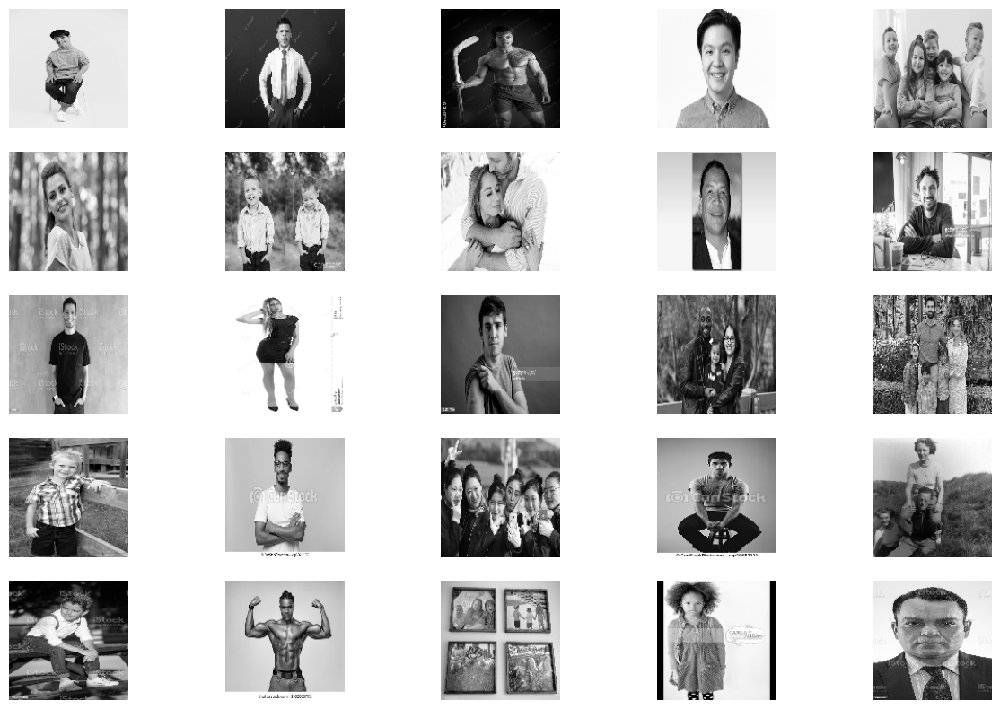

In [15]:
plt.figure(figsize=(15,10))
for i in range(25):
  plt.subplot(5, 5, i+1)
  plt.imshow(images[i], cmap='gray')
  plt.axis("off")

**Splitting and Model Building**

In [16]:
x_train, x_test, y_train, y_test = train_test_split(images, bbox, test_size=0.1, random_state=22)

**CNN Model**

In [17]:
model1 = Sequential()

model1.add(Conv2D(32, (3,3), input_shape=(128,128,1), padding="same", activation="leaky_relu"))
model1.add(MaxPool2D(2,2))
model1.add(Conv2D(64, (3,3), padding="same", activation="leaky_relu"))
model1.add(MaxPool2D(2,2))
model1.add(Conv2D(128, (3,3), padding="same", activation="leaky_relu"))
model1.add(MaxPool2D(2,2))
model1.add(Conv2D(256, (3,3), padding="same", activation="leaky_relu"))
model1.add(MaxPool2D(2,2))
model1.add(GlobalAveragePooling2D())
model1.add(Dense(256, activation="leaky_relu"))
model1.add(Dense(64, activation="leaky_relu"))
model1.add(Dense(48, activation="sigmoid"))

In [18]:
model1.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 128, 128, 32)      320       
                                                                 
 max_pooling2d (MaxPooling2D  (None, 64, 64, 32)       0         
 )                                                               
                                                                 
 conv2d_1 (Conv2D)           (None, 64, 64, 64)        18496     
                                                                 
 max_pooling2d_1 (MaxPooling  (None, 32, 32, 64)       0         
 2D)                                                             
                                                                 
 conv2d_2 (Conv2D)           (None, 32, 32, 128)       73856     
                                                                 
 max_pooling2d_2 (MaxPooling  (None, 16, 16, 128)      0

In [19]:
class CustomCallbacks(keras.callbacks.Callback):
  def on_epoch_end(self,epoch,logs={}):
    prediction = model1.predict(x_test[0].reshape(1, 128, 128, 1))
    fig, ax = plt.subplots(1)
    ax.imshow(x_test[0])
    x1 = int(prediction[0][0]*128)
    y1 = int(prediction[0][1]*128)
    x2 = int(prediction[0][2]*128)
    y2 = int(prediction[0][3]*128)
    rect = patches.Rectangle((x1, y1), x2-x1, y2-y1, linewidth=1,edgecolor='r', facecolor="none")
    ax.add_patch(rect)
    plt.show()

In [20]:
model1.compile(optimizer = "adam", loss="binary_crossentropy")

Epoch 1/60
1/1 [==============================] - 0s 159ms/steposs: 0.20


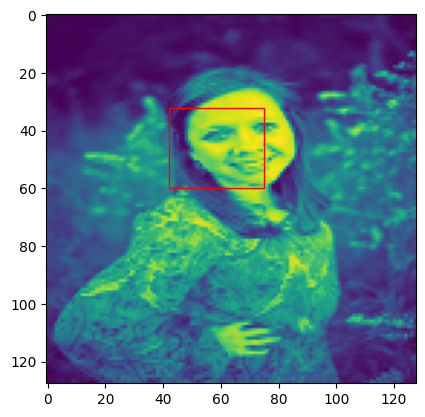

62/62 [==============================] - 45s 681ms/step - loss: 0.2009 - val_loss: 0.1268
Epoch 2/60
1/1 [==============================] - 0s 27ms/steploss: 0.13


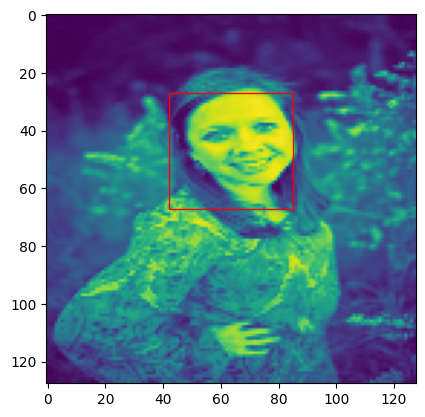

62/62 [==============================] - 40s 650ms/step - loss: 0.1314 - val_loss: 0.1147
Epoch 3/60
1/1 [==============================] - 0s 36ms/steploss: 0.12


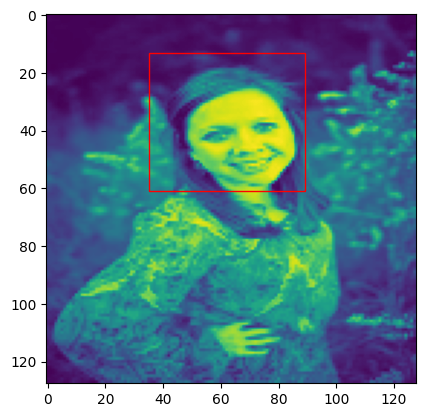

62/62 [==============================] - 43s 680ms/step - loss: 0.1254 - val_loss: 0.1142
Epoch 4/60
1/1 [==============================] - 0s 47ms/steploss: 0.12


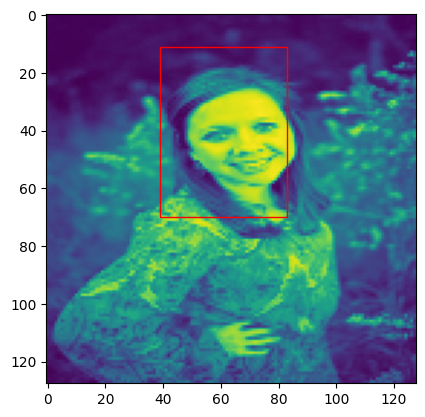

62/62 [==============================] - 58s 932ms/step - loss: 0.1234 - val_loss: 0.1120
Epoch 5/60
1/1 [==============================] - 0s 32ms/steploss: 0.12


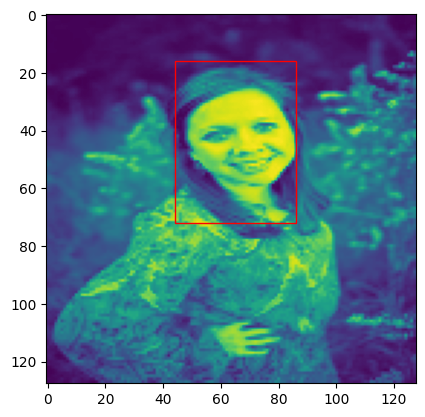

62/62 [==============================] - 70s 1s/step - loss: 0.1209 - val_loss: 0.1091
Epoch 6/60
1/1 [==============================] - 0s 52ms/steploss: 0.11


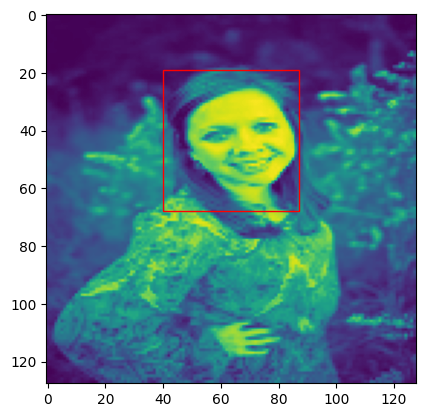

62/62 [==============================] - 47s 762ms/step - loss: 0.1165 - val_loss: 0.1088
Epoch 7/60
1/1 [==============================] - 0s 61ms/steploss: 0.11


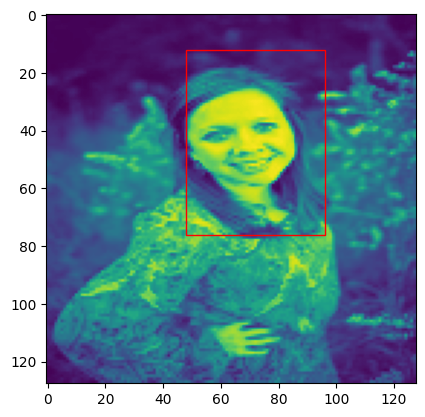

62/62 [==============================] - 76s 1s/step - loss: 0.1162 - val_loss: 0.1096
Epoch 8/60
1/1 [==============================] - 0s 67ms/steploss: 0.11


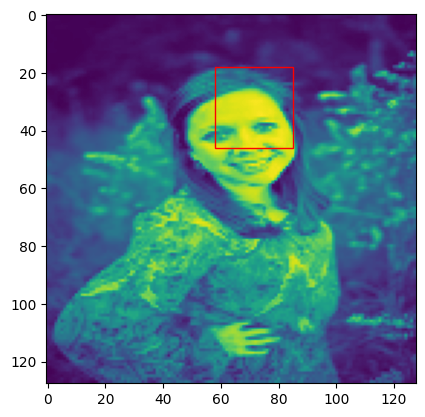

62/62 [==============================] - 97s 2s/step - loss: 0.1161 - val_loss: 0.1126
Epoch 9/60
1/1 [==============================] - 0s 86ms/steploss: 0.11


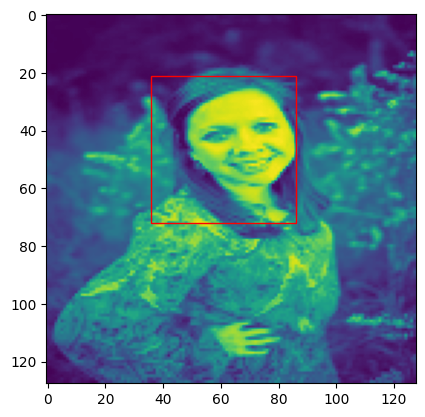

62/62 [==============================] - 82s 1s/step - loss: 0.1173 - val_loss: 0.1132
Epoch 10/60
1/1 [==============================] - 0s 216ms/steposs: 0.11


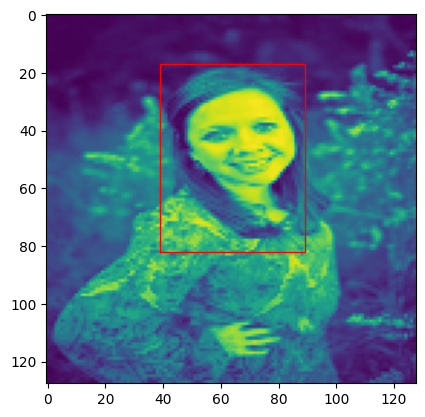

62/62 [==============================] - 78s 1s/step - loss: 0.1154 - val_loss: 0.1103
Epoch 11/60
1/1 [==============================] - 0s 50ms/steploss: 0.11


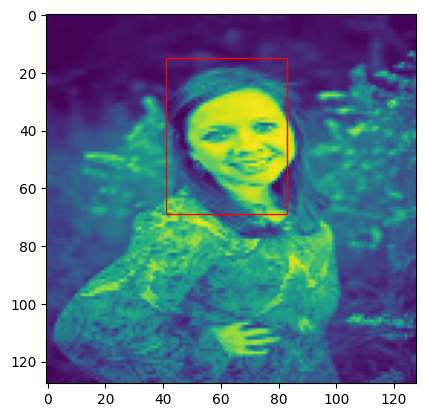

62/62 [==============================] - 60s 966ms/step - loss: 0.1136 - val_loss: 0.1074
Epoch 12/60
1/1 [==============================] - 0s 298ms/steposs: 0.11


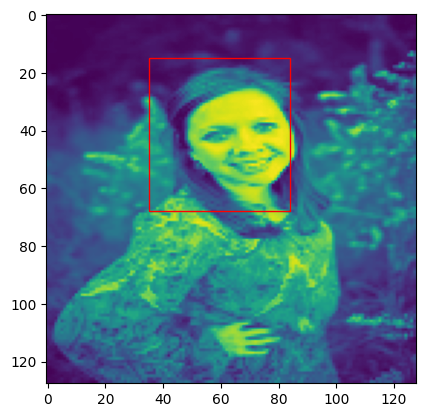

62/62 [==============================] - 89s 1s/step - loss: 0.1128 - val_loss: 0.1094
Epoch 13/60
1/1 [==============================] - 0s 29ms/steploss: 0.11


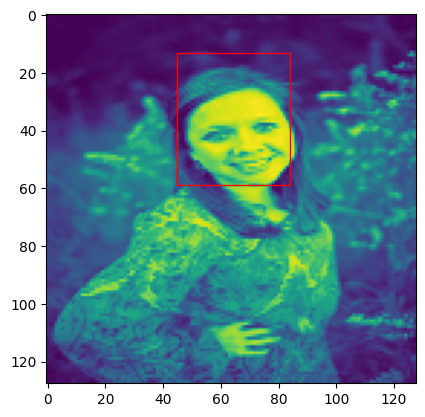

62/62 [==============================] - 62s 988ms/step - loss: 0.1124 - val_loss: 0.1067
Epoch 14/60
1/1 [==============================] - 0s 28ms/steploss: 0.11


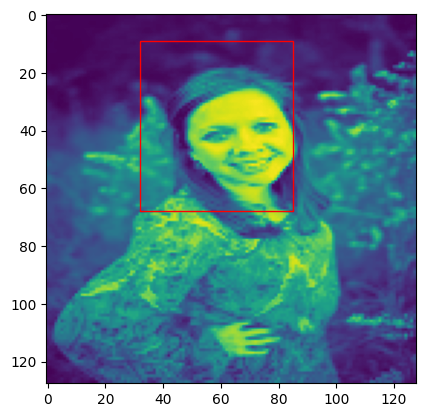

62/62 [==============================] - 38s 613ms/step - loss: 0.1120 - val_loss: 0.1071
Epoch 15/60
1/1 [==============================] - 0s 48ms/steploss: 0.11


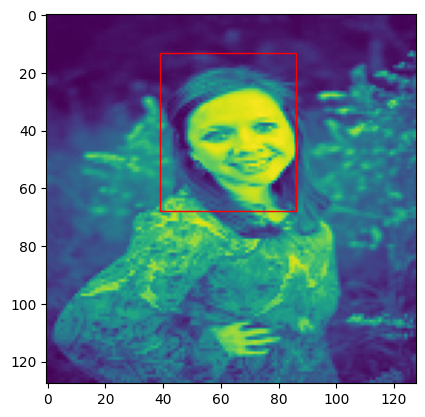

62/62 [==============================] - 54s 874ms/step - loss: 0.1104 - val_loss: 0.1062
Epoch 16/60
1/1 [==============================] - 0s 27ms/steploss: 0.11


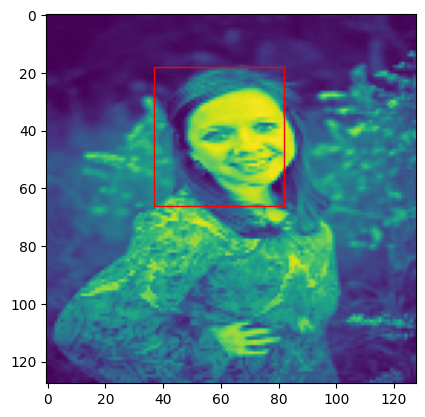

62/62 [==============================] - 39s 624ms/step - loss: 0.1101 - val_loss: 0.1062
Epoch 17/60
1/1 [==============================] - 0s 29ms/steploss: 0.10


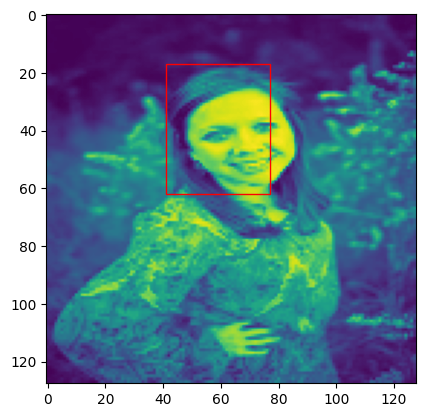

62/62 [==============================] - 39s 623ms/step - loss: 0.1078 - val_loss: 0.1087
Epoch 18/60
1/1 [==============================] - 0s 37ms/steploss: 0.10


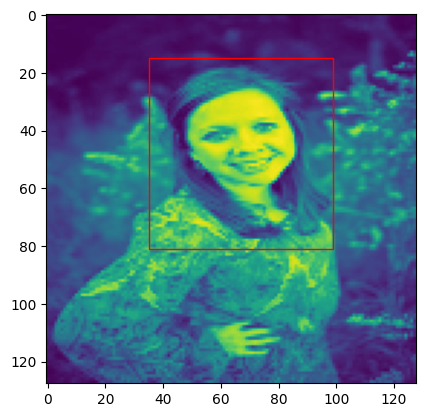

62/62 [==============================] - 41s 655ms/step - loss: 0.1085 - val_loss: 0.1044
Epoch 19/60
1/1 [==============================] - 0s 27ms/steploss: 0.10


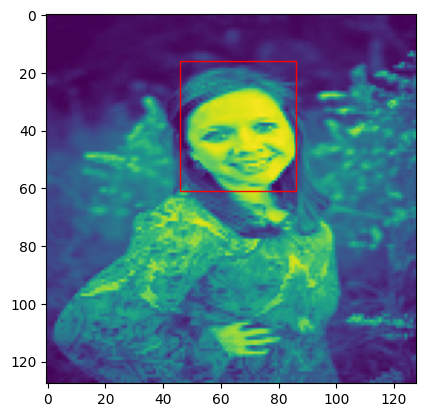

62/62 [==============================] - 37s 597ms/step - loss: 0.1063 - val_loss: 0.1082
Epoch 20/60
1/1 [==============================] - 0s 28ms/steploss: 0.10


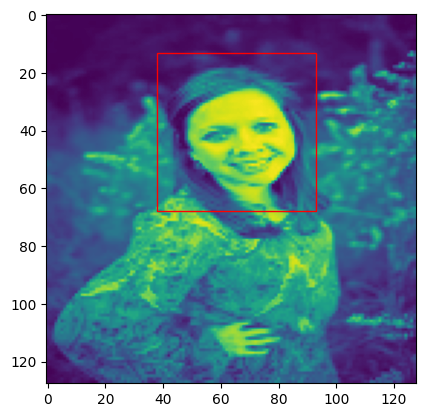

62/62 [==============================] - 36s 576ms/step - loss: 0.1071 - val_loss: 0.1024
Epoch 21/60
1/1 [==============================] - 0s 162ms/steposs: 0.10


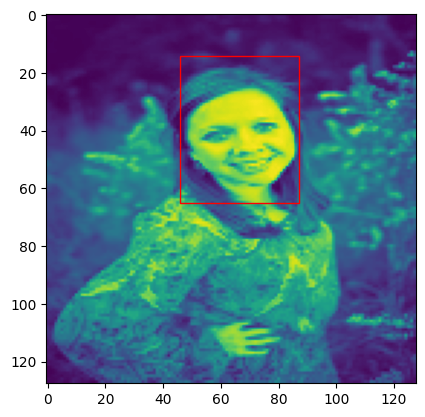

62/62 [==============================] - 37s 589ms/step - loss: 0.1054 - val_loss: 0.1022
Epoch 22/60
1/1 [==============================] - 0s 30ms/steploss: 0.10


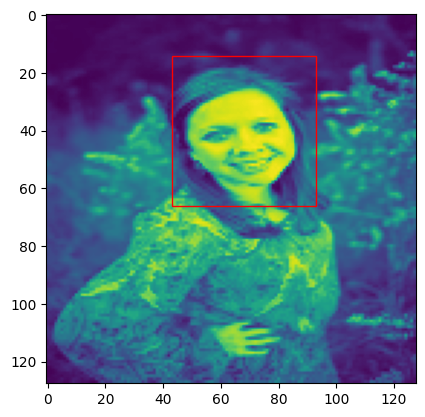

62/62 [==============================] - 36s 572ms/step - loss: 0.1054 - val_loss: 0.1019
Epoch 23/60
1/1 [==============================] - 0s 34ms/steploss: 0.10


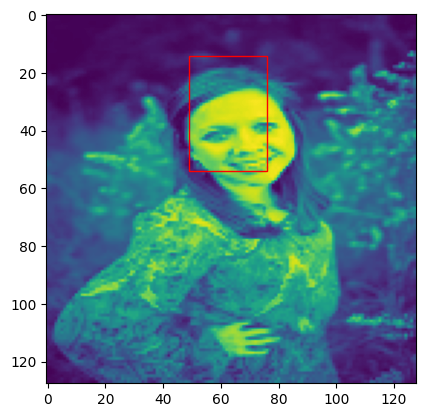

62/62 [==============================] - 39s 635ms/step - loss: 0.1052 - val_loss: 0.1035
Epoch 24/60
1/1 [==============================] - 0s 37ms/steploss: 0.10


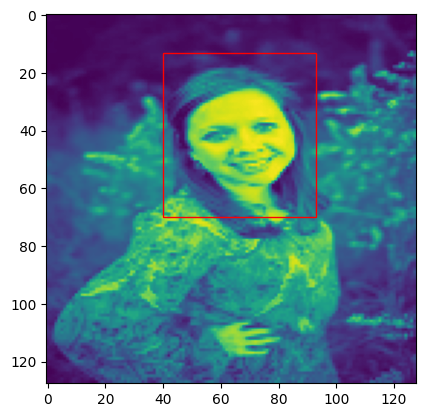

62/62 [==============================] - 41s 655ms/step - loss: 0.1046 - val_loss: 0.1076
Epoch 25/60
1/1 [==============================] - 0s 124ms/steposs: 0.10


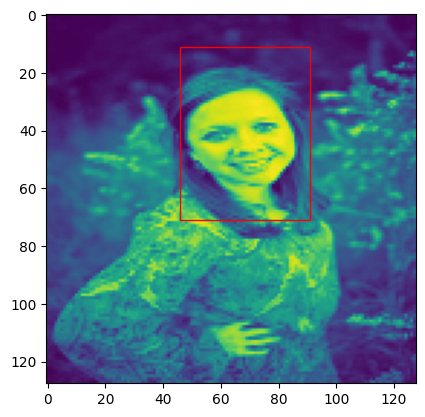

62/62 [==============================] - 125s 2s/step - loss: 0.1045 - val_loss: 0.1016
Epoch 26/60
1/1 [==============================] - 0s 104ms/steposs: 0.10


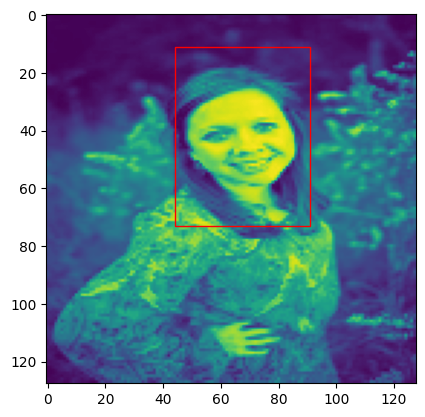

62/62 [==============================] - 104s 2s/step - loss: 0.1058 - val_loss: 0.1013
Epoch 27/60
1/1 [==============================] - 0s 47ms/steploss: 0.10


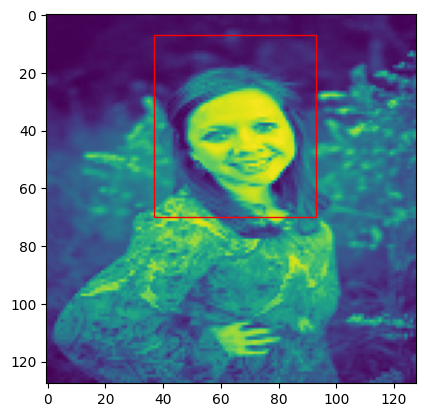

62/62 [==============================] - 76s 1s/step - loss: 0.1032 - val_loss: 0.1062
Epoch 28/60
1/1 [==============================] - 0s 78ms/steploss: 0.10


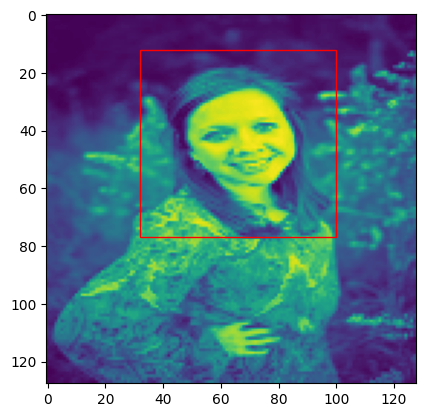

62/62 [==============================] - 85s 1s/step - loss: 0.1042 - val_loss: 0.1016
Epoch 29/60
1/1 [==============================] - 0s 29ms/steploss: 0.10


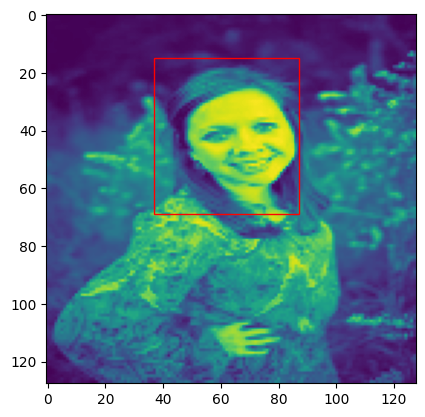

62/62 [==============================] - 57s 896ms/step - loss: 0.1013 - val_loss: 0.1070
Epoch 30/60
1/1 [==============================] - 0s 32ms/steploss: 0.10


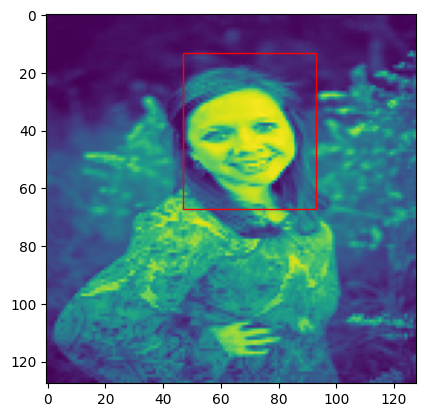

62/62 [==============================] - 35s 558ms/step - loss: 0.1021 - val_loss: 0.1027
Epoch 31/60
1/1 [==============================] - 0s 35ms/steploss: 0.10


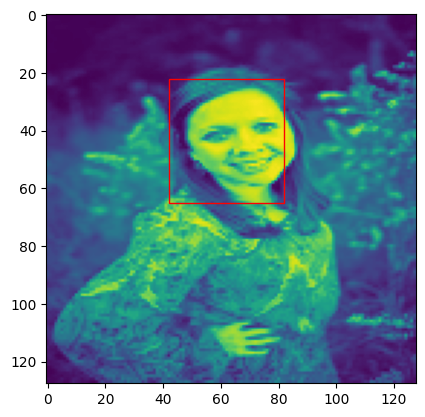

62/62 [==============================] - 36s 572ms/step - loss: 0.1023 - val_loss: 0.1050
Epoch 32/60
1/1 [==============================] - 0s 33ms/steploss: 0.10


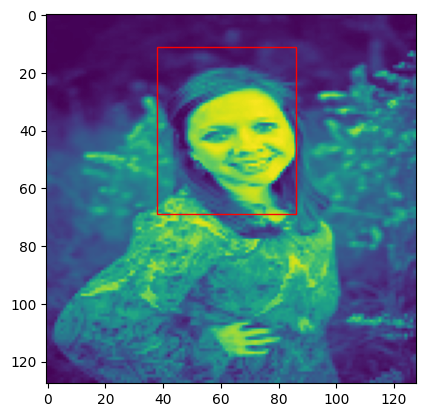

62/62 [==============================] - 35s 561ms/step - loss: 0.1024 - val_loss: 0.1008
Epoch 33/60
1/1 [==============================] - 0s 71ms/steploss: 0.10


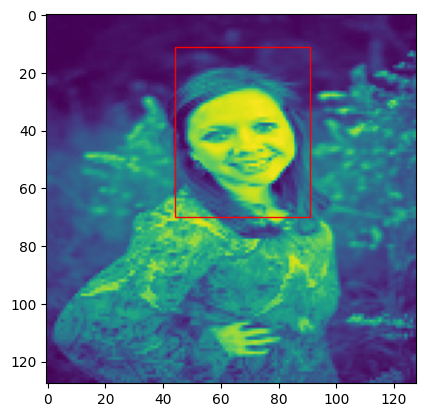

62/62 [==============================] - 51s 822ms/step - loss: 0.1002 - val_loss: 0.1017
Epoch 34/60
1/1 [==============================] - 0s 55ms/steploss: 0.09


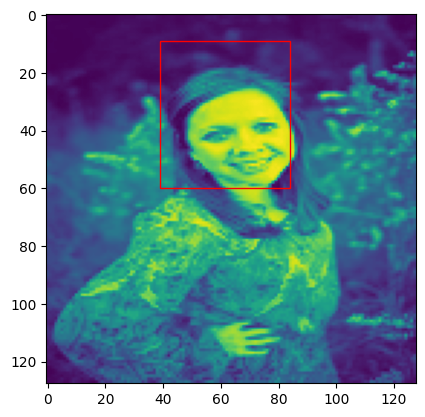

62/62 [==============================] - 51s 814ms/step - loss: 0.0991 - val_loss: 0.1047
Epoch 35/60
1/1 [==============================] - 0s 39ms/steploss: 0.10


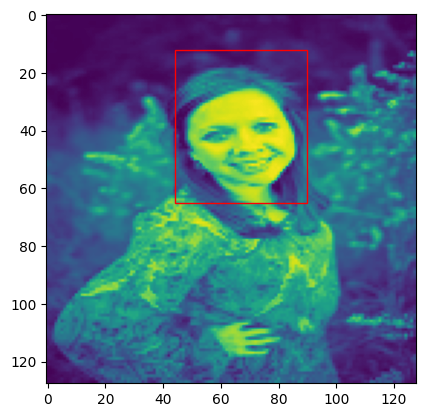

62/62 [==============================] - 42s 666ms/step - loss: 0.1004 - val_loss: 0.0997
Epoch 36/60
1/1 [==============================] - 0s 54ms/steploss: 0.09


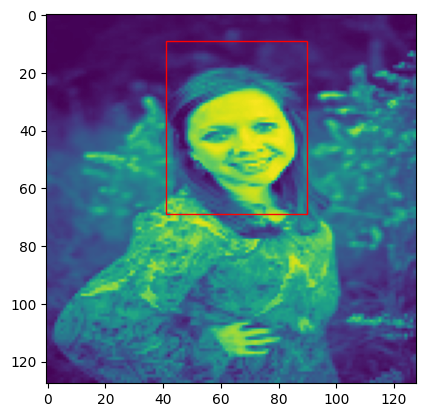

62/62 [==============================] - 40s 639ms/step - loss: 0.0979 - val_loss: 0.1005
Epoch 37/60
1/1 [==============================] - 0s 53ms/steploss: 0.09


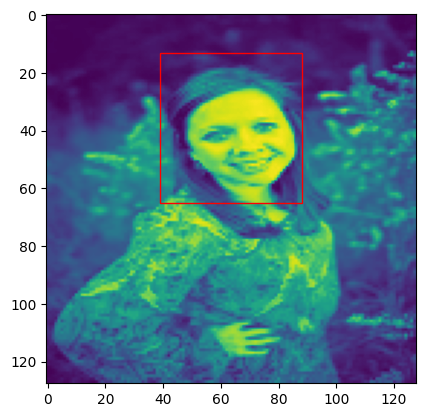

62/62 [==============================] - 41s 653ms/step - loss: 0.0982 - val_loss: 0.1024
Epoch 38/60
1/1 [==============================] - 0s 41ms/steploss: 0.10


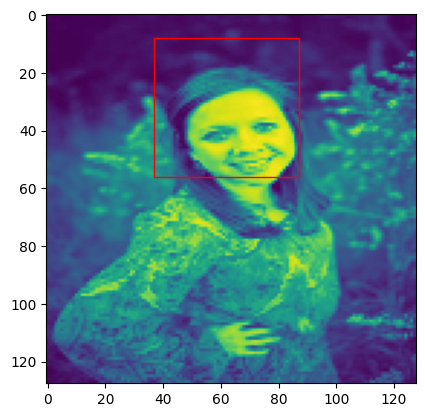

62/62 [==============================] - 39s 627ms/step - loss: 0.1001 - val_loss: 0.1026
Epoch 39/60
1/1 [==============================] - 0s 53ms/steploss: 0.09


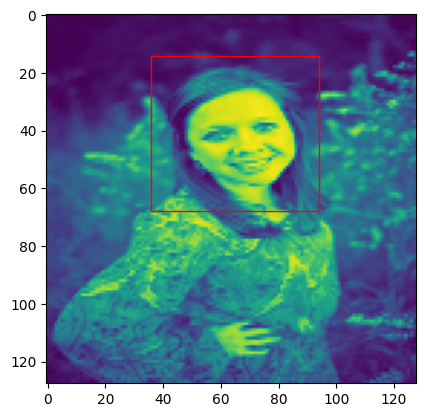

62/62 [==============================] - 40s 635ms/step - loss: 0.0983 - val_loss: 0.1004
Epoch 40/60
1/1 [==============================] - 0s 56ms/steploss: 0.09


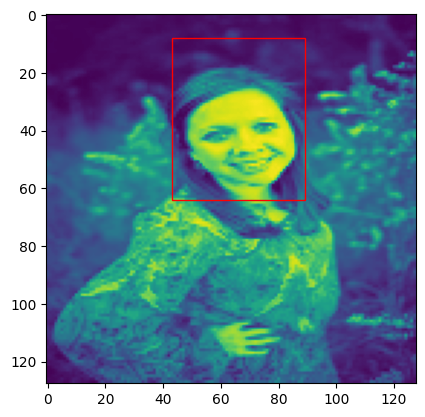

62/62 [==============================] - 41s 655ms/step - loss: 0.0966 - val_loss: 0.0987
Epoch 41/60
1/1 [==============================] - 0s 53ms/steploss: 0.09


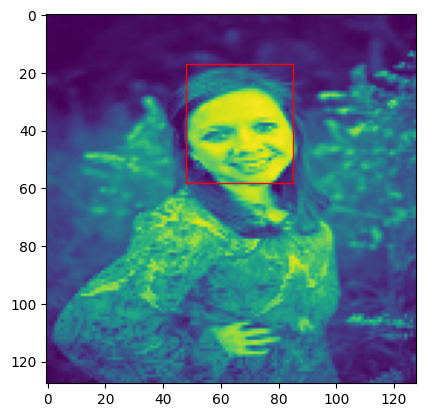

62/62 [==============================] - 41s 658ms/step - loss: 0.0965 - val_loss: 0.0999
Epoch 42/60
1/1 [==============================] - 0s 42ms/steploss: 0.09


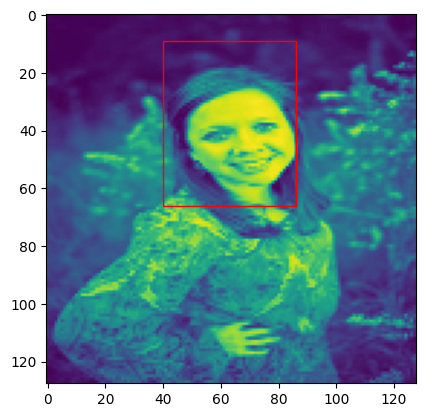

62/62 [==============================] - 41s 655ms/step - loss: 0.0962 - val_loss: 0.1022
Epoch 43/60
1/1 [==============================] - 0s 37ms/steploss: 0.09


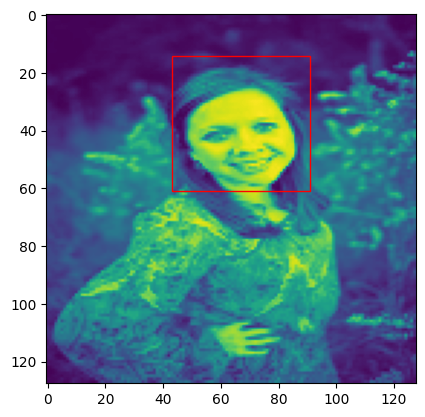

62/62 [==============================] - 41s 649ms/step - loss: 0.0955 - val_loss: 0.0992
Epoch 44/60
1/1 [==============================] - 0s 39ms/steploss: 0.09


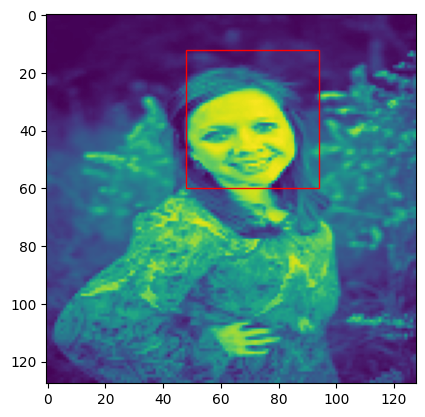

62/62 [==============================] - 41s 651ms/step - loss: 0.0939 - val_loss: 0.0982
Epoch 45/60
1/1 [==============================] - 0s 36ms/steploss: 0.09


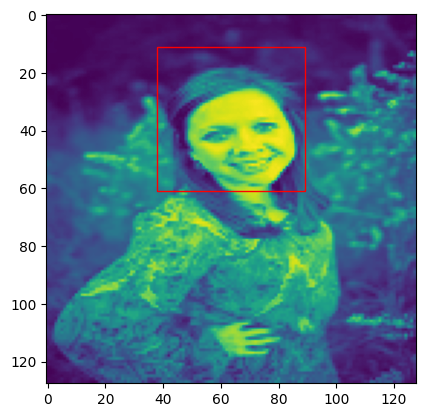

62/62 [==============================] - 40s 643ms/step - loss: 0.0942 - val_loss: 0.1017
Epoch 46/60
1/1 [==============================] - 0s 36ms/steploss: 0.09


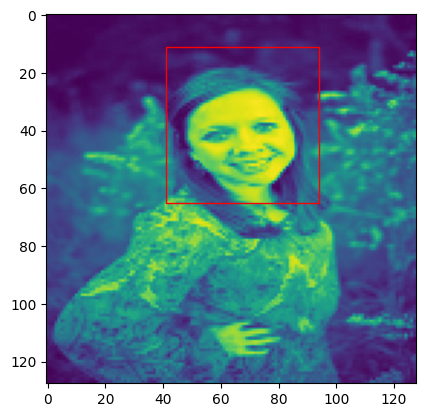

62/62 [==============================] - 41s 648ms/step - loss: 0.0964 - val_loss: 0.1027
Epoch 47/60
1/1 [==============================] - 0s 36ms/steploss: 0.09


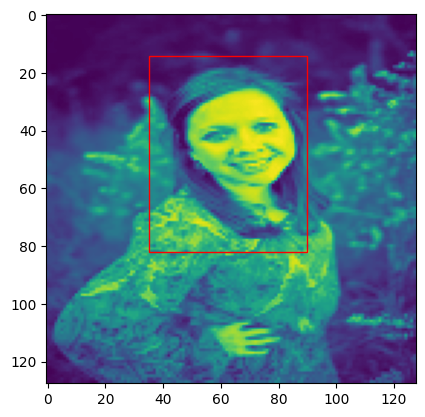

62/62 [==============================] - 42s 660ms/step - loss: 0.0942 - val_loss: 0.0996
Epoch 48/60
1/1 [==============================] - 0s 36ms/steploss: 0.09


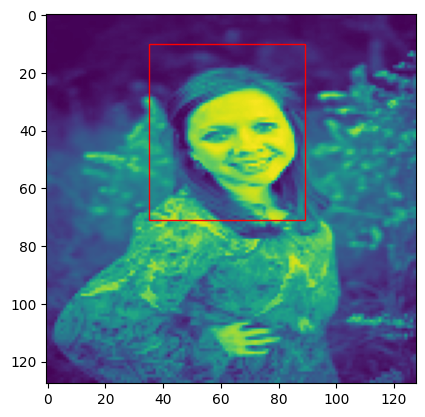

62/62 [==============================] - 41s 654ms/step - loss: 0.0930 - val_loss: 0.1002
Epoch 49/60
1/1 [==============================] - 0s 37ms/steploss: 0.09


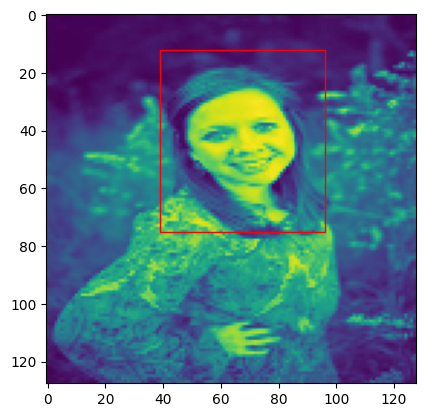

62/62 [==============================] - 42s 656ms/step - loss: 0.0929 - val_loss: 0.1051
Epoch 50/60
1/1 [==============================] - 0s 35ms/steploss: 0.09


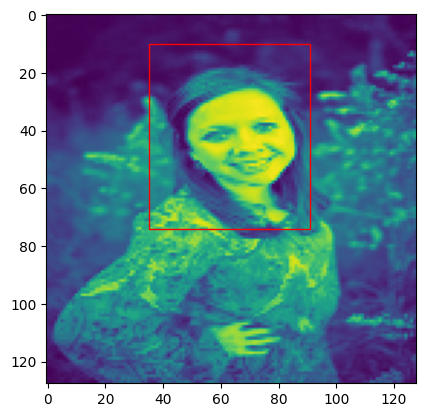

62/62 [==============================] - 47s 751ms/step - loss: 0.0911 - val_loss: 0.1020
Epoch 51/60
1/1 [==============================] - 0s 32ms/steploss: 0.08


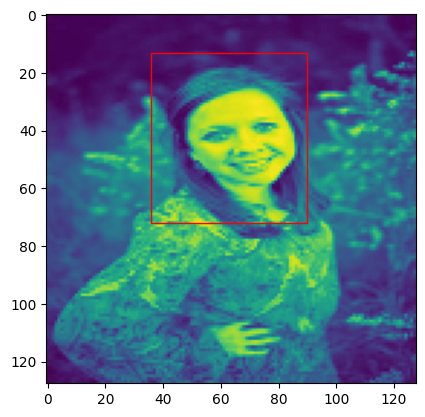

62/62 [==============================] - 37s 601ms/step - loss: 0.0899 - val_loss: 0.0982
Epoch 52/60
1/1 [==============================] - 0s 31ms/steploss: 0.08


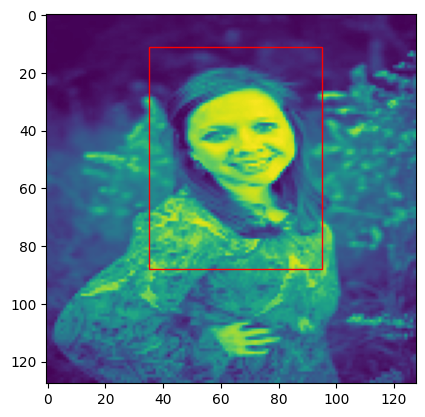

62/62 [==============================] - 36s 579ms/step - loss: 0.0896 - val_loss: 0.1048
Epoch 53/60
1/1 [==============================] - 0s 76ms/steploss: 0.08


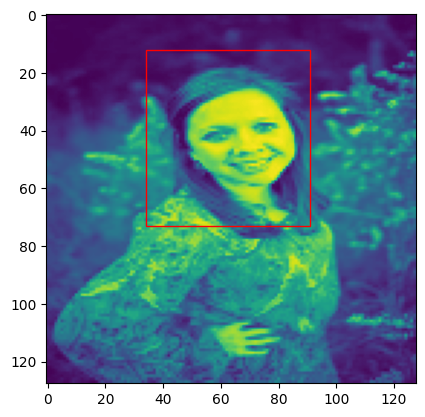

62/62 [==============================] - 53s 863ms/step - loss: 0.0898 - val_loss: 0.1015
Epoch 54/60
1/1 [==============================] - 0s 48ms/steploss: 0.09


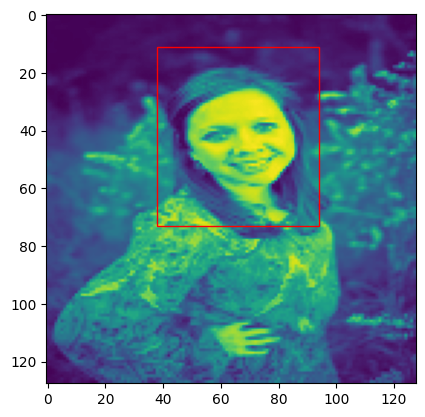

62/62 [==============================] - 66s 1s/step - loss: 0.0901 - val_loss: 0.1011
Epoch 55/60
1/1 [==============================] - 0s 31ms/steploss: 0.08


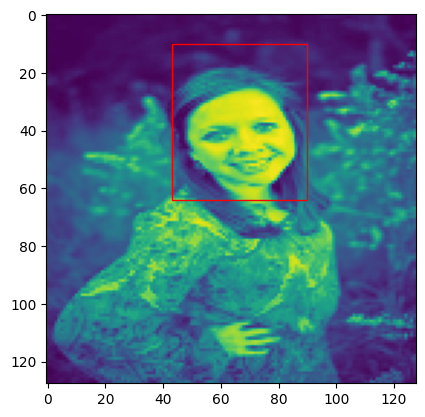

62/62 [==============================] - 39s 617ms/step - loss: 0.0880 - val_loss: 0.1003
Epoch 56/60
1/1 [==============================] - 0s 51ms/steploss: 0.08


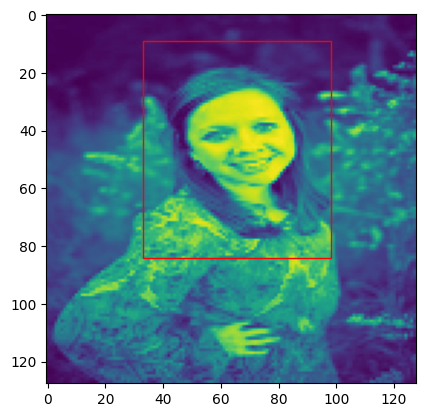

62/62 [==============================] - 40s 636ms/step - loss: 0.0876 - val_loss: 0.1025
Epoch 57/60
1/1 [==============================] - 0s 46ms/steploss: 0.08


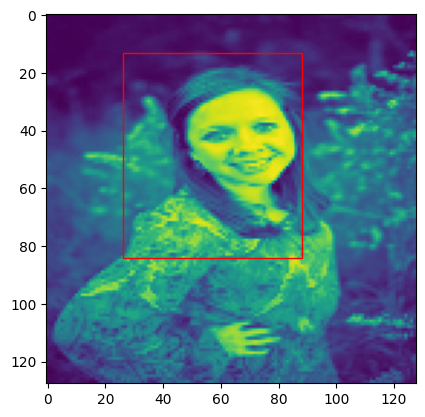

62/62 [==============================] - 42s 659ms/step - loss: 0.0872 - val_loss: 0.1005
Epoch 58/60
1/1 [==============================] - 0s 32ms/steploss: 0.08


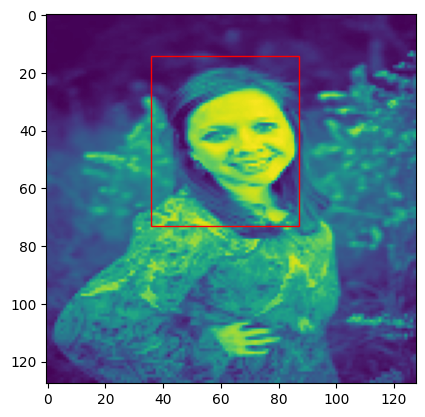

62/62 [==============================] - 42s 663ms/step - loss: 0.0878 - val_loss: 0.1011
Epoch 59/60
1/1 [==============================] - 0s 38ms/steploss: 0.08


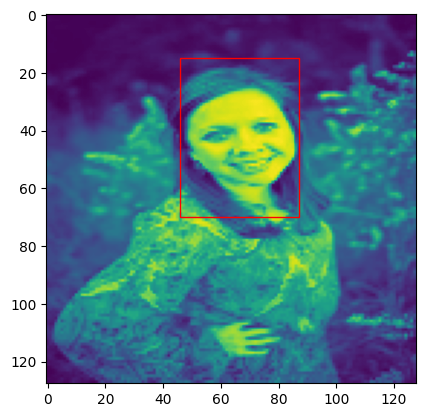

62/62 [==============================] - 42s 673ms/step - loss: 0.0860 - val_loss: 0.1037
Epoch 60/60
1/1 [==============================] - 0s 41ms/steploss: 0.08


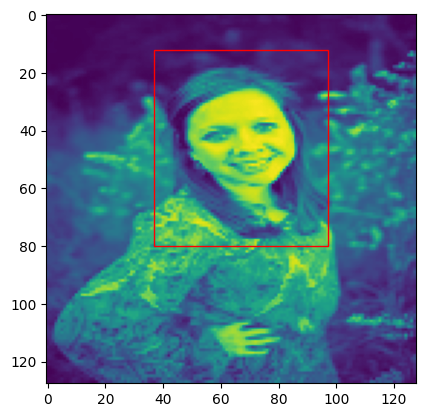

62/62 [==============================] - 42s 675ms/step - loss: 0.0856 - val_loss: 0.1056


In [21]:
history1 = model1.fit(x_train, y_train, validation_data=(x_test, y_test), epochs=60, callbacks=[CustomCallbacks()])

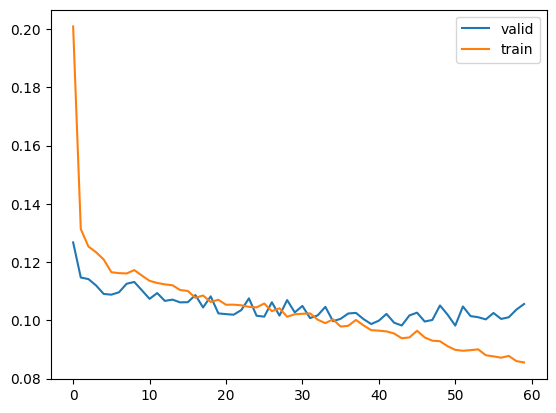

In [22]:
plt.plot(history1.history["val_loss"])
plt.plot(history1.history["loss"])
plt.legend(["valid", "train"])
plt.show()

In [23]:
y_pred = model1.predict(x_test)

7/7 [==============================] - 1s 179ms/step


In [24]:
print(f"mean absolute error is {mean_absolute_error(y_pred, y_test)}")

mean absolute error is 0.02488275995667329


**CNN Model with Dropout and BatchNormalization Layer**

In [25]:
model2 = Sequential()

model2.add(Conv2D(32, (3,3), input_shape=(128,128,1), activation="relu"))
model2.add(Dropout(0.1))
model2.add(MaxPool2D(2,2))
model2.add(BatchNormalization())
model2.add(Conv2D(64, (3,3), activation="relu"))
model2.add(Dropout(0.1))
model2.add(MaxPool2D(2,2))
model2.add(BatchNormalization())
model2.add(Conv2D(128, (3,3), activation="relu"))
model2.add(Dropout(0.2))
model2.add(MaxPool2D(2,2))
model2.add(BatchNormalization())
model2.add(Conv2D(256, (3,3), activation="relu"))
model2.add(Dropout(0.3))
model2.add(MaxPool2D(2,2))
model2.add(BatchNormalization())
model2.add(GlobalAveragePooling2D())
model2.add(Dense(256, activation="leaky_relu"))
model2.add(Dense(48, activation="sigmoid"))

In [26]:
model2.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_4 (Conv2D)           (None, 126, 126, 32)      320       
                                                                 
 dropout (Dropout)           (None, 126, 126, 32)      0         
                                                                 
 max_pooling2d_4 (MaxPooling  (None, 63, 63, 32)       0         
 2D)                                                             
                                                                 
 batch_normalization (BatchN  (None, 63, 63, 32)       128       
 ormalization)                                                   
                                                                 
 conv2d_5 (Conv2D)           (None, 61, 61, 64)        18496     
                                                                 
 dropout_1 (Dropout)         (None, 61, 61, 64)       

In [27]:
class CustomCallbacks2(keras.callbacks.Callback):
  def on_epoch_end(self,epoch,logs={}):
    prediction = model2.predict(x_test[0].reshape(1, 128, 128, 1))
    fig, ax = plt.subplots(1)
    ax.imshow(x_test[0])
    x1 = int(prediction[0][0]*128)
    y1 = int(prediction[0][1]*128)
    x2 = int(prediction[0][2]*128)
    y2 = int(prediction[0][3]*128)
    rect = patches.Rectangle((x1, y1), x2-x1, y2-y1, linewidth=1,edgecolor='r', facecolor="none")
    ax.add_patch(rect)
    plt.show()

In [28]:
model2.compile(optimizer="adam", loss="binary_crossentropy")

Epoch 1/60
1/1 [==============================] - 0s 294ms/step loss: 0.15


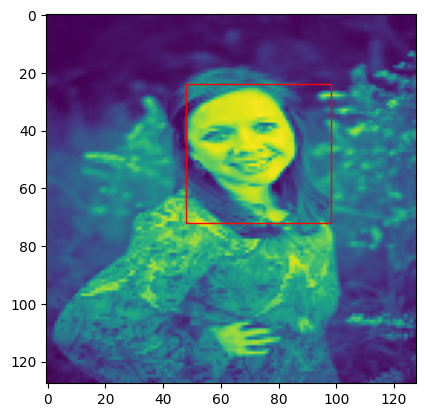

248/248 [==============================] - 65s 241ms/step - loss: 0.1546 - val_loss: 0.1450
Epoch 2/60
1/1 [==============================] - 0s 104ms/step loss: 0.12


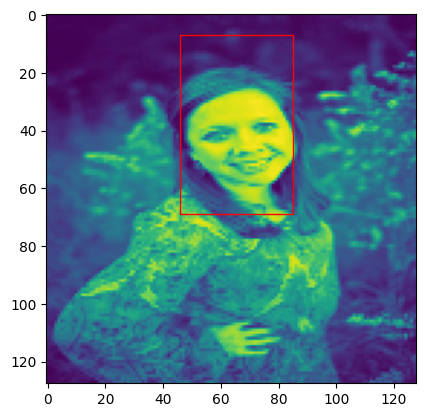

248/248 [==============================] - 58s 232ms/step - loss: 0.1248 - val_loss: 0.1574
Epoch 3/60
1/1 [==============================] - 0s 62ms/step- loss: 0.11


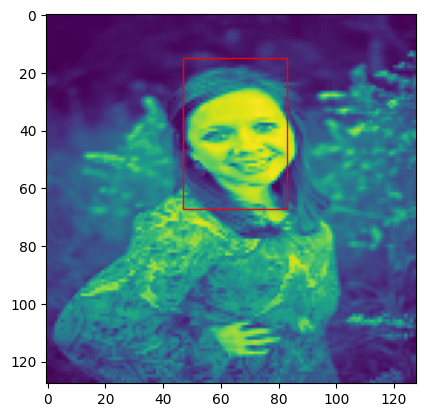

248/248 [==============================] - 57s 230ms/step - loss: 0.1177 - val_loss: 0.1130
Epoch 4/60
1/1 [==============================] - 0s 37ms/step- loss: 0.11


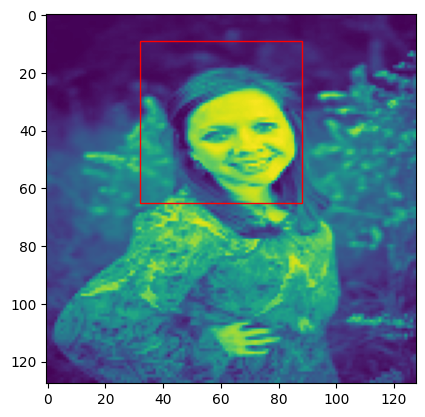

248/248 [==============================] - 57s 229ms/step - loss: 0.1166 - val_loss: 0.1352
Epoch 5/60
1/1 [==============================] - 0s 45ms/step- loss: 0.11


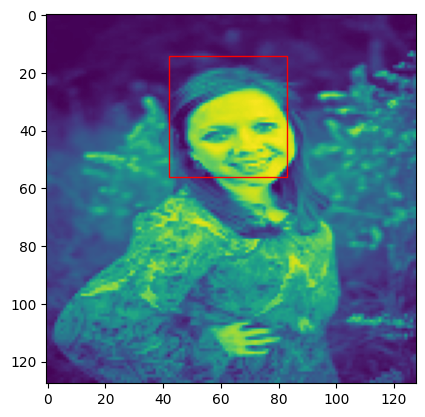

248/248 [==============================] - 57s 229ms/step - loss: 0.1154 - val_loss: 0.1460
Epoch 6/60
1/1 [==============================] - 0s 41ms/step- loss: 0.11


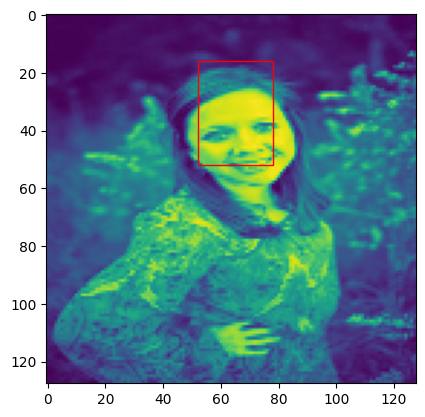

248/248 [==============================] - 56s 224ms/step - loss: 0.1138 - val_loss: 0.1155
Epoch 7/60
1/1 [==============================] - 0s 35ms/step- loss: 0.11


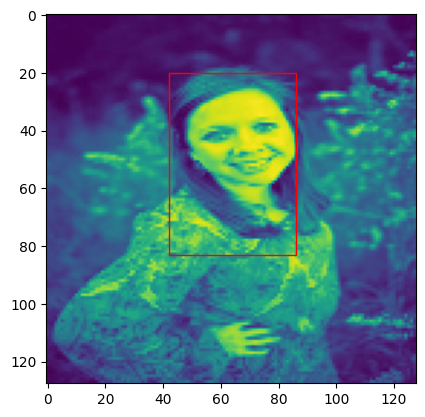

248/248 [==============================] - 54s 218ms/step - loss: 0.1133 - val_loss: 0.1145
Epoch 8/60
1/1 [==============================] - 0s 141ms/step loss: 0.11


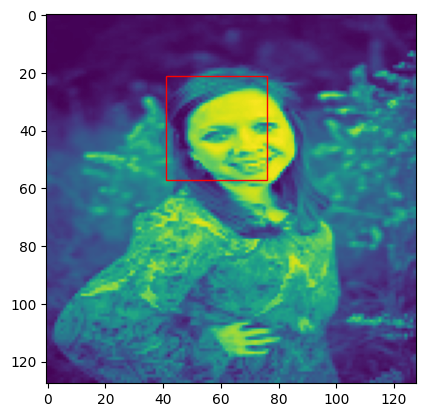

248/248 [==============================] - 57s 231ms/step - loss: 0.1123 - val_loss: 0.1079
Epoch 9/60
1/1 [==============================] - 0s 36ms/step- loss: 0.11


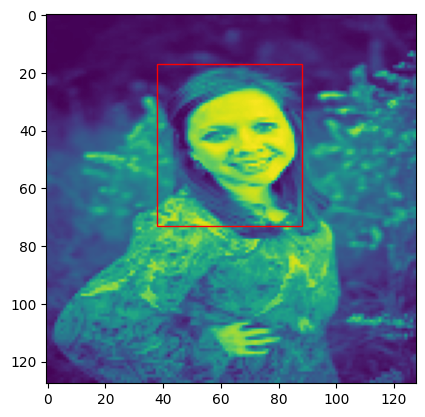

248/248 [==============================] - 57s 229ms/step - loss: 0.1107 - val_loss: 0.1040
Epoch 10/60
1/1 [==============================] - 0s 40ms/step- loss: 0.10


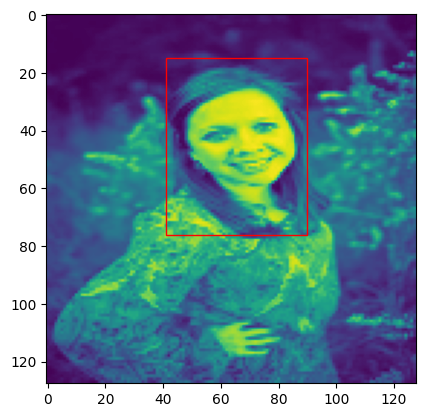

248/248 [==============================] - 57s 227ms/step - loss: 0.1099 - val_loss: 0.1326
Epoch 11/60
1/1 [==============================] - 0s 36ms/step- loss: 0.10


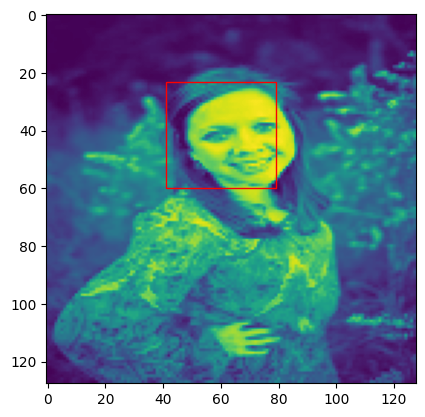

248/248 [==============================] - 55s 222ms/step - loss: 0.1081 - val_loss: 0.1127
Epoch 12/60
1/1 [==============================] - 0s 39ms/step- loss: 0.10


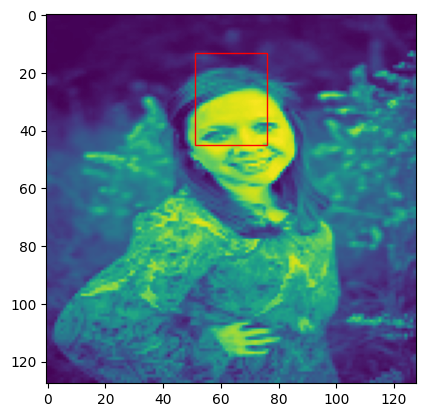

248/248 [==============================] - 56s 227ms/step - loss: 0.1064 - val_loss: 0.1218
Epoch 13/60
1/1 [==============================] - 0s 44ms/step- loss: 0.10


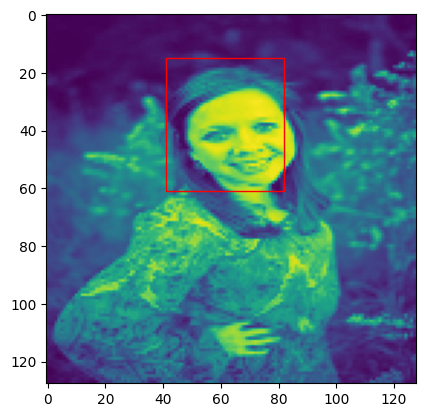

248/248 [==============================] - 56s 226ms/step - loss: 0.1071 - val_loss: 0.1163
Epoch 14/60
1/1 [==============================] - 0s 31ms/step- loss: 0.10


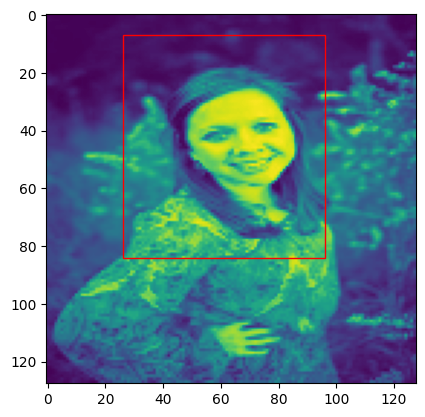

248/248 [==============================] - 58s 233ms/step - loss: 0.1072 - val_loss: 0.1433
Epoch 15/60
1/1 [==============================] - 0s 35ms/step- loss: 0.10


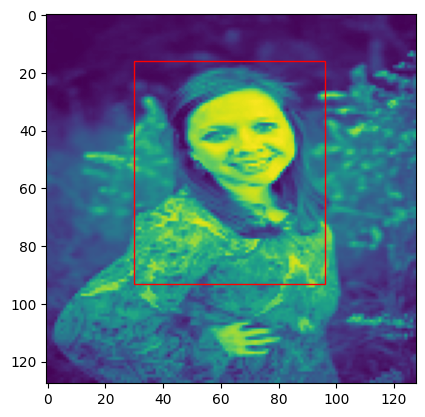

248/248 [==============================] - 56s 227ms/step - loss: 0.1052 - val_loss: 0.1178
Epoch 16/60
1/1 [==============================] - 0s 51ms/step- loss: 0.10


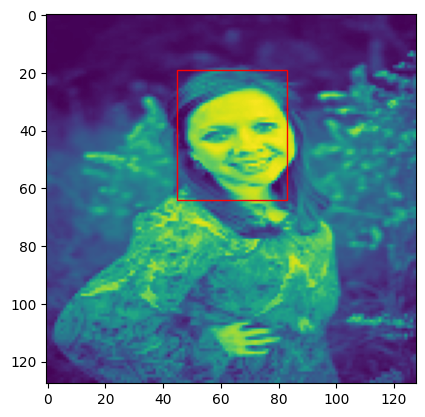

248/248 [==============================] - 56s 226ms/step - loss: 0.1038 - val_loss: 0.1184
Epoch 17/60
1/1 [==============================] - 0s 33ms/step- loss: 0.10


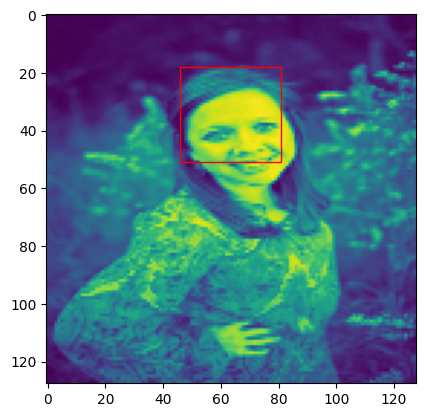

248/248 [==============================] - 58s 231ms/step - loss: 0.1044 - val_loss: 0.1043
Epoch 18/60
1/1 [==============================] - 0s 35ms/step- loss: 0.10


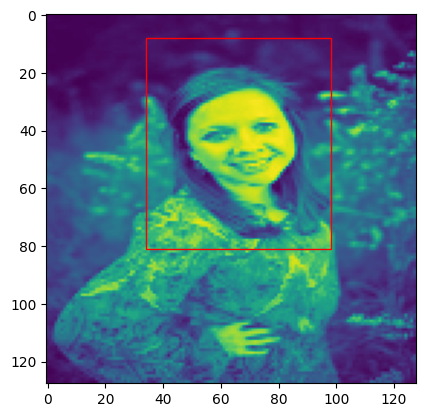

248/248 [==============================] - 55s 223ms/step - loss: 0.1031 - val_loss: 0.1204
Epoch 19/60
1/1 [==============================] - 0s 42ms/step- loss: 0.10


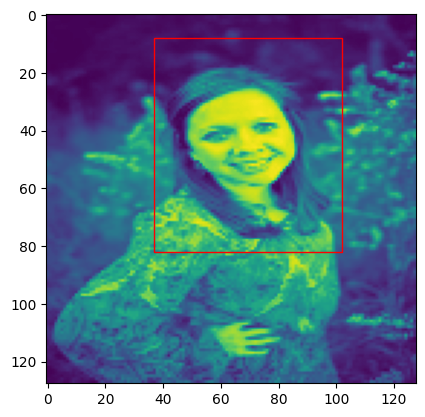

248/248 [==============================] - 56s 225ms/step - loss: 0.1005 - val_loss: 0.1264
Epoch 20/60
1/1 [==============================] - 0s 32ms/step- loss: 0.10


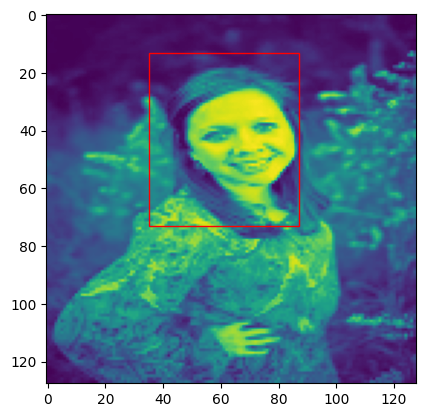

248/248 [==============================] - 56s 227ms/step - loss: 0.1001 - val_loss: 0.1322
Epoch 21/60
1/1 [==============================] - 0s 37ms/step- loss: 0.09


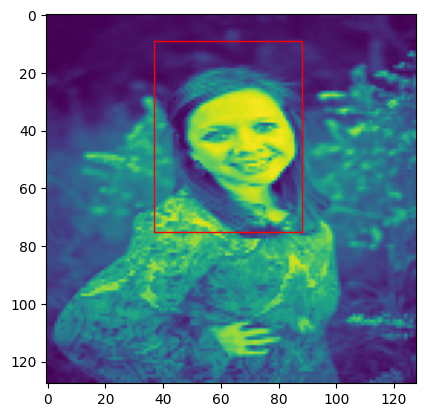

248/248 [==============================] - 58s 234ms/step - loss: 0.0991 - val_loss: 0.1137
Epoch 22/60
1/1 [==============================] - 0s 40ms/step- loss: 0.09


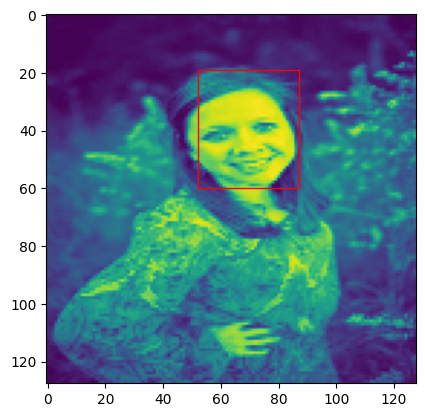

248/248 [==============================] - 58s 232ms/step - loss: 0.0977 - val_loss: 0.1087
Epoch 23/60
1/1 [==============================] - 0s 36ms/step- loss: 0.09


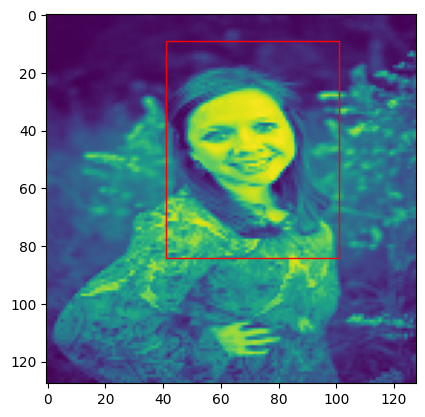

248/248 [==============================] - 58s 234ms/step - loss: 0.0977 - val_loss: 0.1218
Epoch 24/60
1/1 [==============================] - 0s 36ms/step- loss: 0.09


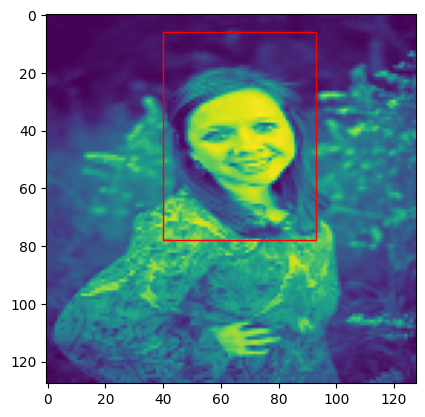

248/248 [==============================] - 56s 227ms/step - loss: 0.0962 - val_loss: 0.1555
Epoch 25/60
1/1 [==============================] - 0s 33ms/step- loss: 0.09


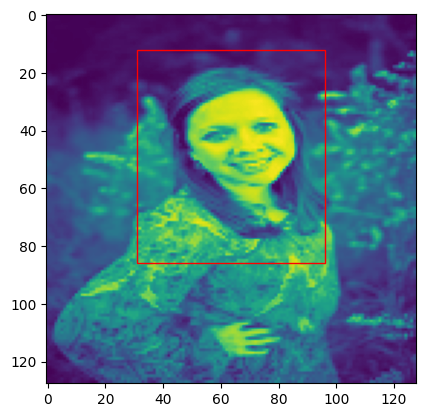

248/248 [==============================] - 60s 243ms/step - loss: 0.0958 - val_loss: 0.1483
Epoch 26/60
1/1 [==============================] - 0s 35ms/step- loss: 0.09


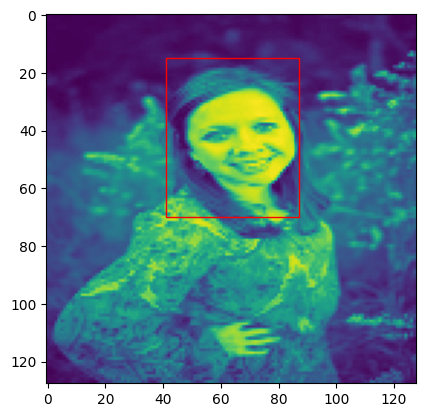

248/248 [==============================] - 56s 227ms/step - loss: 0.0959 - val_loss: 0.1030
Epoch 27/60
1/1 [==============================] - 0s 29ms/step- loss: 0.09


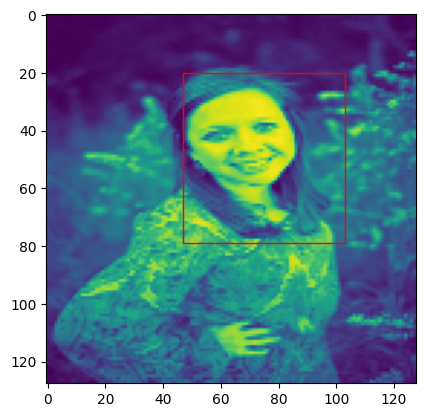

248/248 [==============================] - 54s 219ms/step - loss: 0.0934 - val_loss: 0.1217
Epoch 28/60
1/1 [==============================] - 0s 41ms/step- loss: 0.09


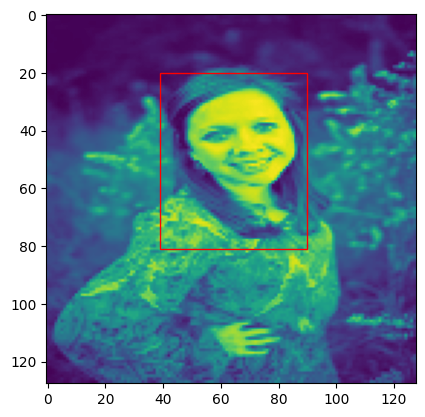

248/248 [==============================] - 57s 230ms/step - loss: 0.0928 - val_loss: 0.1296
Epoch 29/60
1/1 [==============================] - 0s 35ms/step- loss: 0.09


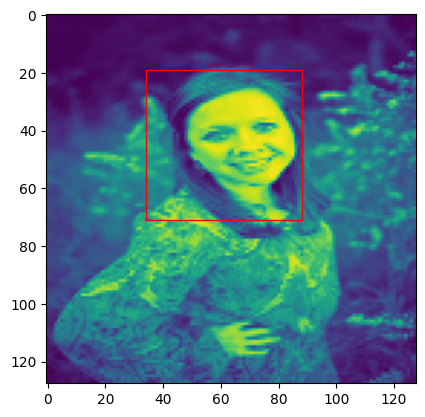

248/248 [==============================] - 61s 247ms/step - loss: 0.0924 - val_loss: 0.1076
Epoch 30/60
1/1 [==============================] - 0s 32ms/step- loss: 0.09


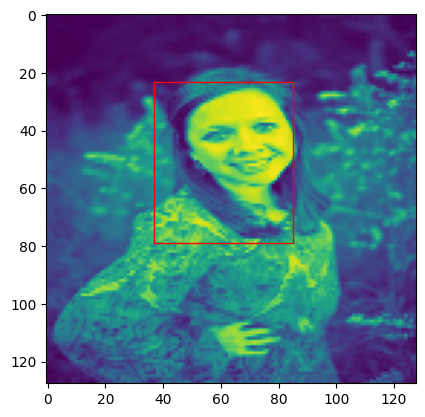

248/248 [==============================] - 54s 218ms/step - loss: 0.0908 - val_loss: 0.1145
Epoch 31/60
1/1 [==============================] - 0s 32ms/step- loss: 0.08


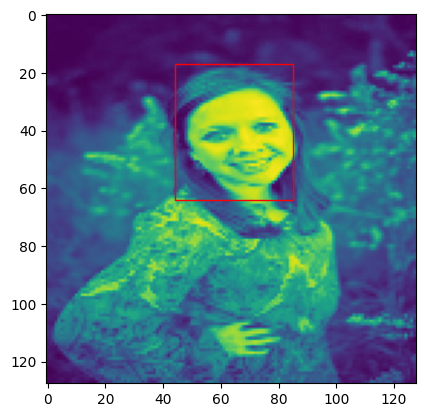

248/248 [==============================] - 54s 215ms/step - loss: 0.0888 - val_loss: 0.1158
Epoch 32/60
1/1 [==============================] - 0s 29ms/step- loss: 0.08


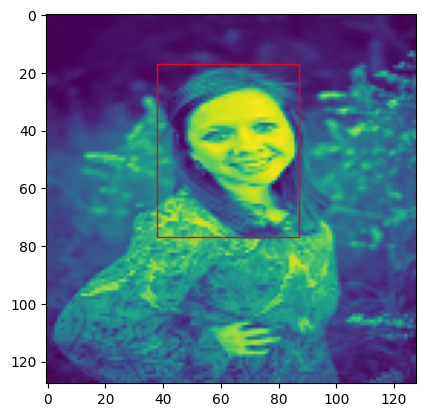

248/248 [==============================] - 50s 200ms/step - loss: 0.0891 - val_loss: 0.1261
Epoch 33/60
1/1 [==============================] - 0s 25ms/step- loss: 0.08


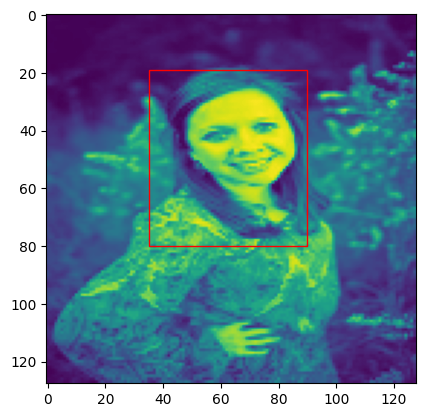

248/248 [==============================] - 49s 197ms/step - loss: 0.0881 - val_loss: 0.1350
Epoch 34/60
1/1 [==============================] - 0s 48ms/step- loss: 0.08


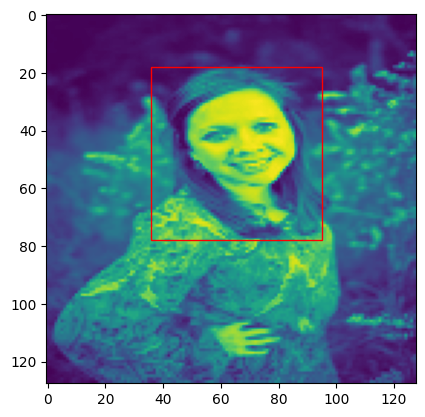

248/248 [==============================] - 60s 243ms/step - loss: 0.0873 - val_loss: 0.1075
Epoch 35/60
1/1 [==============================] - 0s 46ms/step- loss: 0.08


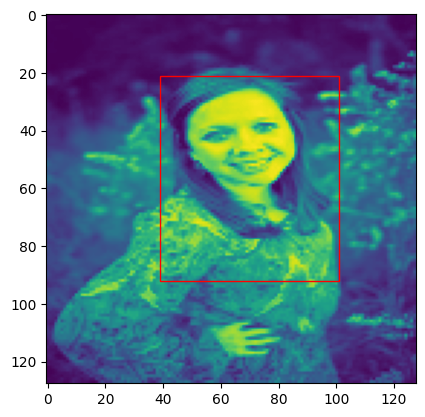

248/248 [==============================] - 58s 235ms/step - loss: 0.0855 - val_loss: 0.1229
Epoch 36/60
1/1 [==============================] - 0s 36ms/step- loss: 0.08


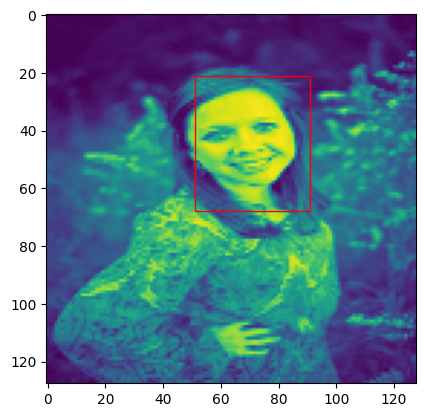

248/248 [==============================] - 58s 234ms/step - loss: 0.0857 - val_loss: 0.1151
Epoch 37/60
1/1 [==============================] - 0s 31ms/step- loss: 0.08


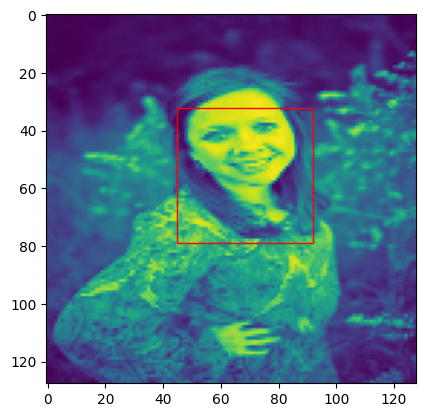

248/248 [==============================] - 59s 236ms/step - loss: 0.0841 - val_loss: 0.1414
Epoch 38/60
1/1 [==============================] - 0s 36ms/step- loss: 0.08


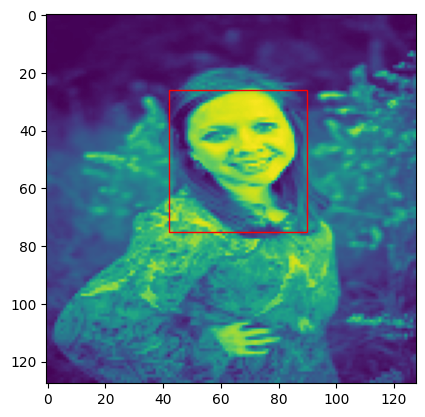

248/248 [==============================] - 53s 213ms/step - loss: 0.0840 - val_loss: 0.1255
Epoch 39/60
1/1 [==============================] - 0s 41ms/step- loss: 0.08


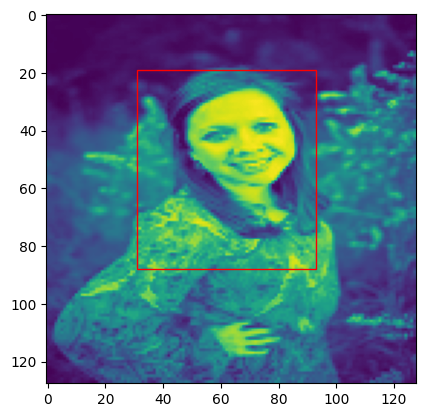

248/248 [==============================] - 53s 214ms/step - loss: 0.0837 - val_loss: 0.1203
Epoch 40/60
1/1 [==============================] - 0s 35ms/step- loss: 0.08


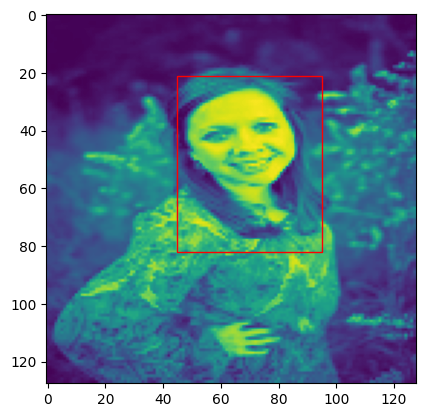

248/248 [==============================] - 54s 217ms/step - loss: 0.0830 - val_loss: 0.1352
Epoch 41/60
1/1 [==============================] - 0s 37ms/step- loss: 0.08


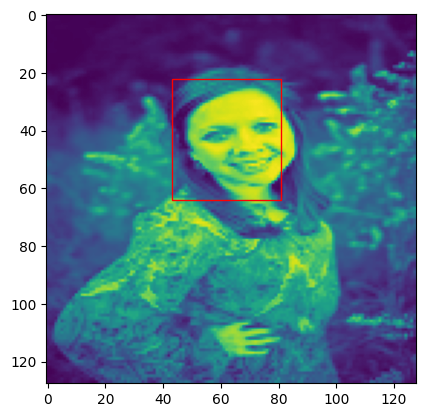

248/248 [==============================] - 54s 217ms/step - loss: 0.0831 - val_loss: 0.1235
Epoch 42/60
1/1 [==============================] - 0s 42ms/step- loss: 0.08


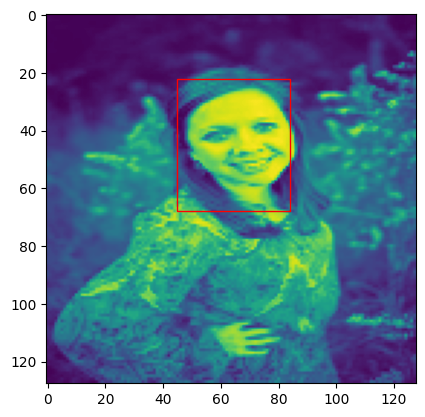

248/248 [==============================] - 53s 213ms/step - loss: 0.0822 - val_loss: 0.1370
Epoch 43/60
1/1 [==============================] - 0s 32ms/step- loss: 0.08


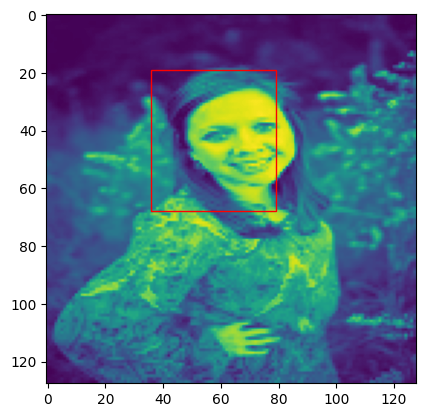

248/248 [==============================] - 53s 214ms/step - loss: 0.0805 - val_loss: 0.1304
Epoch 44/60
1/1 [==============================] - 0s 37ms/step- loss: 0.08


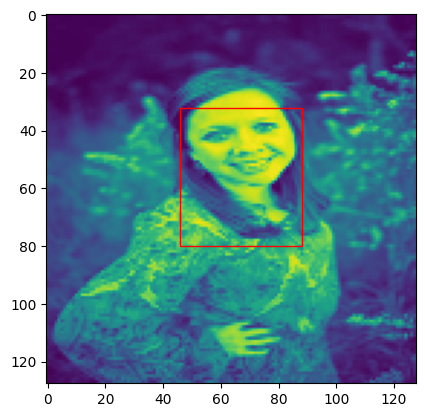

248/248 [==============================] - 53s 215ms/step - loss: 0.0811 - val_loss: 0.1091
Epoch 45/60
1/1 [==============================] - 0s 33ms/step- loss: 0.08


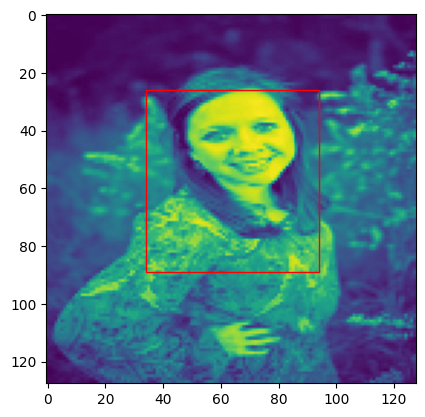

248/248 [==============================] - 54s 217ms/step - loss: 0.0803 - val_loss: 0.1192
Epoch 46/60
1/1 [==============================] - 0s 36ms/step- loss: 0.08


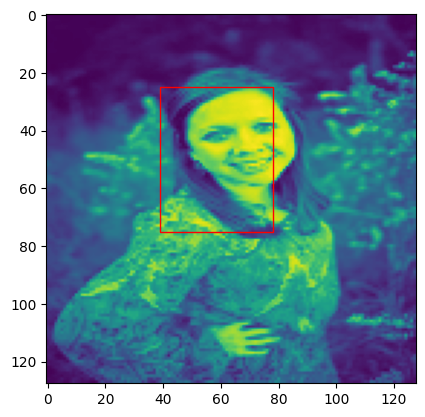

248/248 [==============================] - 53s 213ms/step - loss: 0.0808 - val_loss: 0.1177
Epoch 47/60
1/1 [==============================] - 0s 35ms/step- loss: 0.07


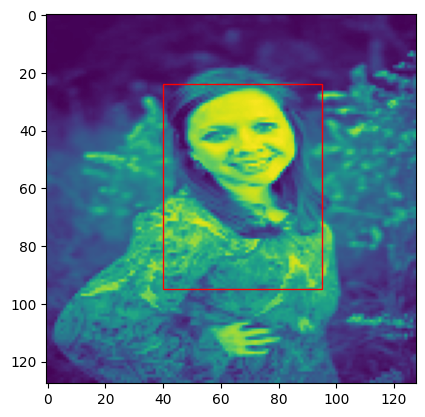

248/248 [==============================] - 53s 213ms/step - loss: 0.0791 - val_loss: 0.1398
Epoch 48/60
1/1 [==============================] - 0s 32ms/step- loss: 0.07


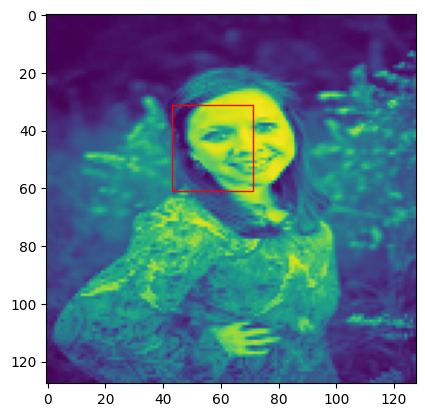

248/248 [==============================] - 59s 239ms/step - loss: 0.0797 - val_loss: 0.1445
Epoch 49/60
1/1 [==============================] - 0s 45ms/step- loss: 0.07


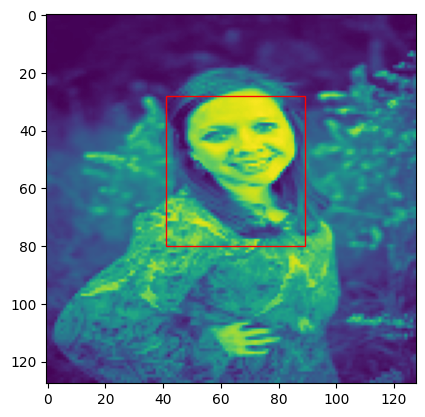

248/248 [==============================] - 56s 227ms/step - loss: 0.0791 - val_loss: 0.1354
Epoch 50/60
1/1 [==============================] - 0s 35ms/step- loss: 0.07


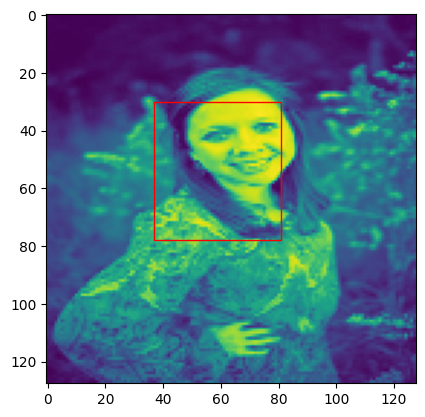

248/248 [==============================] - 56s 226ms/step - loss: 0.0782 - val_loss: 0.1303
Epoch 51/60
1/1 [==============================] - 0s 37ms/step- loss: 0.07


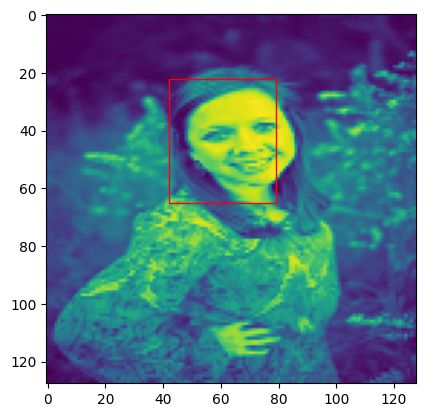

248/248 [==============================] - 55s 223ms/step - loss: 0.0782 - val_loss: 0.1561
Epoch 52/60
1/1 [==============================] - 0s 37ms/step- loss: 0.07


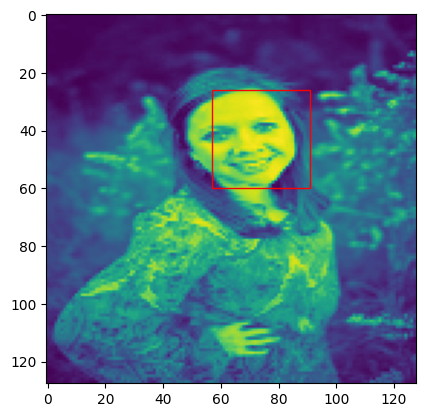

248/248 [==============================] - 56s 226ms/step - loss: 0.0781 - val_loss: 0.1385
Epoch 53/60
1/1 [==============================] - 0s 34ms/step- loss: 0.07


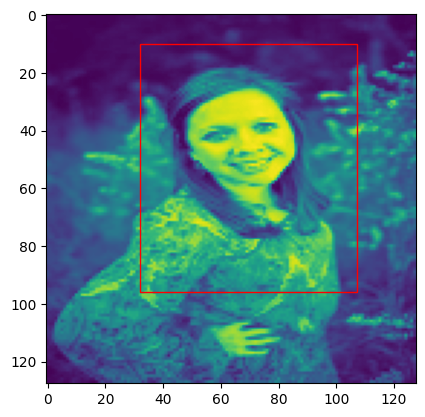

248/248 [==============================] - 56s 226ms/step - loss: 0.0792 - val_loss: 0.1462
Epoch 54/60
1/1 [==============================] - 0s 37ms/step- loss: 0.07


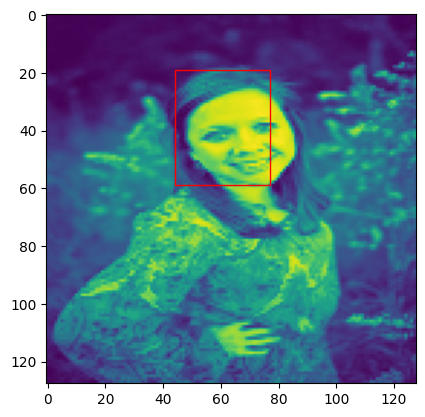

248/248 [==============================] - 56s 226ms/step - loss: 0.0797 - val_loss: 0.1222
Epoch 55/60
1/1 [==============================] - 0s 55ms/step- loss: 0.07


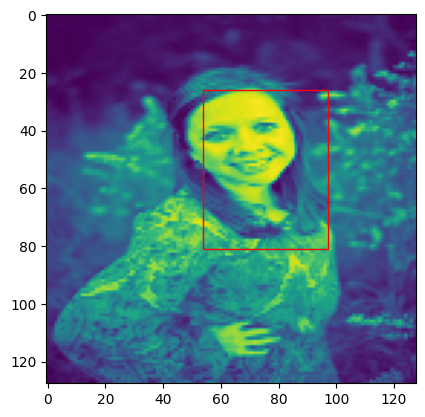

248/248 [==============================] - 57s 229ms/step - loss: 0.0777 - val_loss: 0.1538
Epoch 56/60
1/1 [==============================] - 0s 45ms/step- loss: 0.07


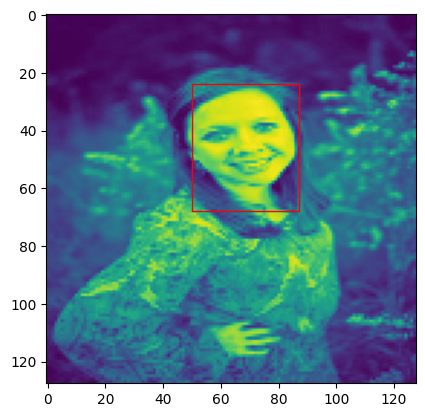

248/248 [==============================] - 57s 228ms/step - loss: 0.0776 - val_loss: 0.1188
Epoch 57/60
1/1 [==============================] - 0s 31ms/step- loss: 0.07


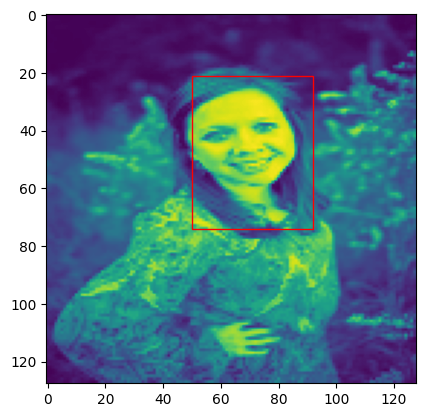

248/248 [==============================] - 57s 227ms/step - loss: 0.0778 - val_loss: 0.1386
Epoch 58/60
1/1 [==============================] - 0s 62ms/step- loss: 0.07


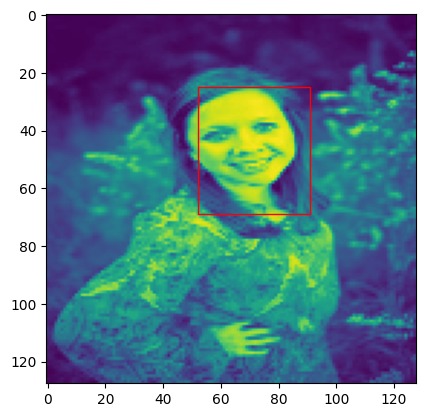

248/248 [==============================] - 56s 225ms/step - loss: 0.0779 - val_loss: 0.1307
Epoch 59/60
1/1 [==============================] - 0s 76ms/step- loss: 0.07


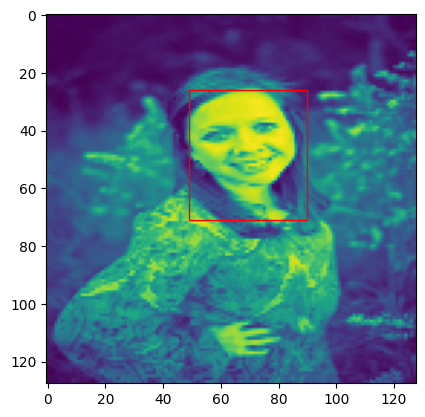

248/248 [==============================] - 56s 226ms/step - loss: 0.0779 - val_loss: 0.1051
Epoch 60/60
1/1 [==============================] - 0s 35ms/step- loss: 0.07


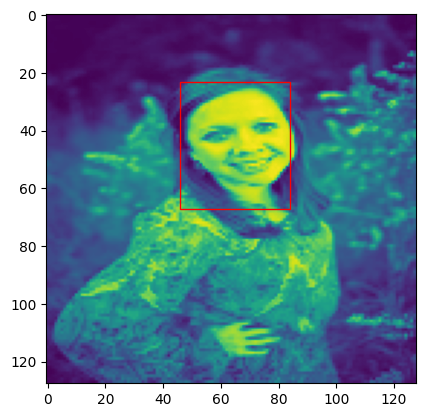

248/248 [==============================] - 57s 229ms/step - loss: 0.0768 - val_loss: 0.1281


In [29]:
history2 = model2.fit(x_train, y_train, validation_data=(x_test, y_test), batch_size=8, epochs=60, callbacks=[CustomCallbacks2()])

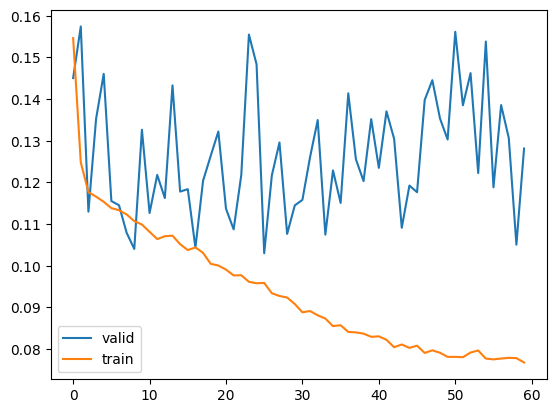

In [30]:
plt.plot(history2.history["val_loss"])
plt.plot(history2.history["loss"])
plt.legend(["valid", "train"])
plt.show()

In [31]:
y_pred2 = model2.predict(x_test)

7/7 [==============================] - 2s 273ms/step


In [32]:
print(f"mean absolute error is {mean_absolute_error(y_pred2, y_test)}")

mean absolute error is 0.024270412538769853


**Plotting the prediction of the models**

In [33]:
def model1_predictions(img_number):
  model1_prediction = model1.predict(x_test[img_number].reshape(1, 128, 128, 1))
  model1_prediction = model1_prediction[0]
  img = x_test[img_number]

  count = 0
  bbox1 = []
  for i in model1_prediction:
    bbox1.append(i)
    count+=1
    if count==4:
      count = 0
      plt.subplot(1,2,1)
      plt.imshow(img)
      x1 = int(bbox1[0]*128)
      y1 = int(bbox1[1]*128)
      x2 = int(bbox1[2]*128)
      y2 = int(bbox1[3]*128)
      plt.gca().add_patch(patches.Rectangle((x1, y1), x2-x1, y2-y1, linewidth=1,edgecolor='r', facecolor="none"))
      bbox1 = []
  plt.show()

1/1 [==============================] - 0s 46ms/step


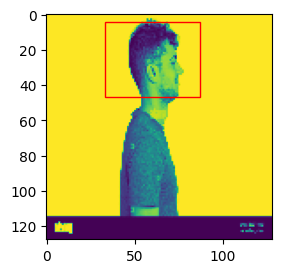

In [34]:
model1_predictions(10)

In [35]:
def model2_predictions(img_number):
  model2_prediction = model2.predict(x_test[img_number].reshape(1, 128, 128, 1))
  model2_prediction = model2_prediction[0]
  img = x_test[img_number]

  count = 0
  bbox1 = []
  for i in model2_prediction:
    bbox1.append(i)
    count+=1
    if count==4:
      count = 0
      plt.subplot(1,2,1)
      plt.imshow(img)
      x1 = int(bbox1[0]*128)
      y1 = int(bbox1[1]*128)
      x2 = int(bbox1[2]*128)
      y2 = int(bbox1[3]*128)
      plt.gca().add_patch(patches.Rectangle((x1, y1), x2-x1, y2-y1, linewidth=1,edgecolor='r', facecolor="none"))
      bbox1 = []
  plt.show()

1/1 [==============================] - 0s 124ms/step


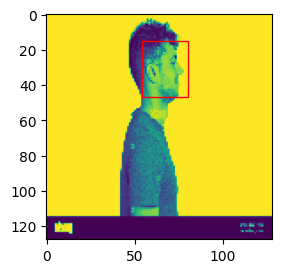

In [36]:
model2_predictions(10)